In [1]:
%matplotlib inline


from keras.models import Model
from keras.callbacks import TensorBoard, EarlyStopping
from keras.layers import LSTM, Dropout, Dense, BatchNormalization, Activation, Input, TimeDistributed
from keras.regularizers import l2
from keras.layers.advanced_activations import LeakyReLU, ELU, PReLU
from keras.optimizers import RMSprop, Adam, Adadelta, Adagrad
import numpy as np
from time import time
from matplotlib import pyplot as plt
from sklearn.preprocessing import binarize

from assignment.helpers import datapreparation as prep

# Note on specifying the initial state of RNNs
# Seems as though you can reset state (probably stateful=True), and then pass an array of initial states that can be used
# in the RNN - so initialize based on composer :D
# https://keras.io/layers/recurrent/

fs5_dirpath = "./assignment/datasets/training/piano_roll_fs5"
fs1_dirpath = "./assignment/datasets/training/piano_roll_fs1"

datasets = prep.load_all_dataset(fs1_dirpath)
dataset_names = prep.load_all_dataset_names(fs1_dirpath)

datasets = [dataset[:, 1:] for dataset in datasets] # Remove the headers

dataset_id_names = dict(zip(np.arange(len(dataset_names)), dataset_names))
longest_song = max(datasets[i].shape[1] for i in range(len(datasets)))
sequence_length = 10 #40
#b_size = 71 # 4047=3*19*71, 0.2 split ==> 3237 = 3*13*83
length = longest_song//sequence_length + 1
num_keys = len(datasets[0])
parts_per_song = int(longest_song/sequence_length)


def transpose_and_label(datasets, num_keys):
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    datasets_transposed_padded_labels = np.array([np.append(dataset[1:, :], np.array([np.ones(num_keys)]), 0) for dataset in datasets_transposed])
    return datasets_transposed, datasets_transposed_padded_labels

def transpose_and_label_stricter(datasets, num_keys):
    xs, ys = [], []
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    for song in datasets_transposed:
        for i in range(0, len(song)//sequence_length):
            xs.append(song[i*sequence_length:(i+1)*sequence_length])
            if i == len(song)//sequence_length - 1: # Add the EOF marker if last seq of song
                ys.append(np.append(song[i*sequence_length+1:(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0))
            else:
                ys.append(song[i*sequence_length+1:(i+1)*sequence_length+1])
    return xs, ys


# Makes several datasets from this first one with differing intervals between to capture the "gaps" between two sequences
def transpose_and_label_more(datasets, num_keys):
    zs = []
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    for song in datasets_transposed:
        for offset in range(0, sequence_length, 1): # Consider dropping offset, and use stateful to retain this info!
            for i in range(0, len(song)//sequence_length-offset):
                x = song[offset+i*sequence_length:offset+(i+1)*sequence_length]
                if i == len(song)//sequence_length - 1: # Add the EOF marker if last seq of song
                    y = np.append(song[offset+i*sequence_length+1:offset+(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0)
                else:
                    y = song[offset+i*sequence_length+1:offset+(i+1)*sequence_length+1]
                zs.append((x,y))
    zs = np.array(zs)
    np.random.shuffle(zs)
    return zs[:, 0], zs[:, 1]

train_xs, train_ys = transpose_and_label_more(datasets, num_keys)

inputs = Input(shape=(sequence_length, num_keys))
# Units = units per timestep LSTM block, i.e. output dimensionality (128 here since input and output 128 keys)
lstm1 = LSTM(num_keys,
               activation='relu',
               return_sequences=True,
               stateful=False,
               dropout=0.0, #0.2, #0.25,
               recurrent_dropout=0.0, #0.25,
               kernel_regularizer=None,#l2(0.0001),
               recurrent_regularizer=None, #l2(0.0001),
               bias_regularizer=None,
               activity_regularizer=None, #l2(0.0001),
               )(inputs)
#lstm = LeakyReLU(alpha=.001)(lstm) # Workaround for getting leakyrelu as activation in lstm
normalized1 = BatchNormalization()(lstm1)
dense1 = Dense(num_keys, activation="sigmoid")(normalized1)
lstm2 = LSTM(num_keys,
               activation='relu',
               return_sequences=True,
               stateful=False,
               dropout=0.0, #0.2, #0.25,
               recurrent_dropout=0.0, #0.25,
               kernel_regularizer=None,#l2(0.0001),
               recurrent_regularizer=None, #l2(0.0001),
               bias_regularizer=None,
               activity_regularizer=None,#l2(0.0001),
               )(dense1)
normalized2 = BatchNormalization()(lstm2)
dense2 = Dense(num_keys, activation="sigmoid")(normalized2)
outputs = TimeDistributed(Dense(num_keys, activation="sigmoid"))(normalized2) # Sigmoid keeps the probabilities independent of each other, while softmax does not!

model = Model(inputs=inputs, outputs=outputs)

rmsprop = RMSprop(lr=0.001)
adagrad =  Adagrad(lr=0.001)
adam = Adam(lr=0.001, amsgrad=True) #Ends up in a point where gradients really small, denominator really small and then loss exploding
adadelta = Adadelta(lr=1.0)

#model.save("./models/latest.h5f")
# When LSTM is done can use trainable=False to freeze it while training the other one


Using TensorFlow backend.


In [2]:
keys_not_played = set([i for i in range(num_keys)])
for dataset in datasets:
    for i in range(num_keys):
        if sum(dataset[i,:]) != 0 and i in keys_not_played:
            keys_not_played.remove(i)
print(keys_not_played)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127}


In [3]:
# Want to penalize each output node independantly. So we pick a binary loss 
# and model the output of the network as a independent bernoulli distributions per label.

model.compile(loss='binary_crossentropy',
              optimizer=adam, # consider changing this one for others
              metrics=['categorical_accuracy'])
print(model.summary())

tensorboard = TensorBoard(log_dir="./logs/{}".format(time()))
early_stop = EarlyStopping(monitor="val_loss", min_delta=0, patience=3, verbose=0, mode="auto")


model.fit(train_xs, train_ys,
          epochs=500, # Train harder more for more things was too bad train man :(
          batch_size=32,
          shuffle=True, # Should consider a generator and stateful so that trains on full songs and resets stats after each one (also pad them so each makes up full seq im training on)
          callbacks=[tensorboard],
          )

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 10, 128)           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 10, 128)           131584    
_________________________________________________________________
batch_normalization_1 (Batch (None, 10, 128)           512       
_________________________________________________________________
dense_1 (Dense)              (None, 10, 128)           16512     
_________________________________________________________________
lstm_2 (LSTM)                (None, 10, 128)           131584    
_________________________________________________________________
batch_normalization_2 (Batch (None, 10, 128)           512       
_________________________________________________________________
time_distributed_1 (TimeDist (None, 10, 128)           16512     
Total para

11675/11675 [==============================] - 22s 2ms/step - loss: 0.0179 - categorical_accuracy: 0.3709
Epoch 99/500
11675/11675 [==============================] - 23s 2ms/step - loss: 0.0178 - categorical_accuracy: 0.3710
Epoch 100/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0177 - categorical_accuracy: 0.3735
Epoch 101/500
11675/11675 [==============================] - 25s 2ms/step - loss: 0.0176 - categorical_accuracy: 0.3716
Epoch 102/500
11675/11675 [==============================] - 17s 1ms/step - loss: 0.0176 - categorical_accuracy: 0.3718 1s - loss: 0.0176 - categorical_accuracy:  - ETA: 1s - loss: 0.0176 - 
Epoch 103/500
11675/11675 [==============================] - 27s 2ms/step - loss: 0.0176 - categorical_accuracy: 0.3732
Epoch 104/500
11675/11675 [==============================] - 18s 2ms/step - loss: 0.0174 - categorical_accuracy: 0.3750A: 16s - loss: 0.0169 - categorical_accuracy: 0.37 - ETA:  - ETA: 6s - loss: 0.0173 - ca - ETA: 2s
Epoch 

11675/11675 [==============================] - 23s 2ms/step - loss: 0.0131 - categorical_accuracy: 0.3904 2s
Epoch 208/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0131 - categorical_accuracy: 0.3903
Epoch 209/500
11675/11675 [==============================] - 26s 2ms/step - loss: 0.0131 - categorical_accuracy: 0.3907
Epoch 210/500
11675/11675 [==============================] - 17s 1ms/step - loss: 0.0130 - categorical_accuracy: 0.3907
Epoch 211/500
11675/11675 [==============================] - 25s 2ms/step - loss: 0.0130 - categorical_accuracy: 0.3904
Epoch 212/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0131 - categorical_accuracy: 0.3912A: 13s - loss: 0.0128 -
Epoch 213/500
11675/11675 [==============================] - 22s 2ms/step - loss: 0.0131 - categorical_accuracy: 0.3905
Epoch 214/500
11675/11675 [==============================] - 23s 2ms/step - loss: 0.0130 - categorical_accuracy: 0.3891 2s - loss: 0.0130 -  - ETA: 

11675/11675 [==============================] - 23s 2ms/step - loss: 0.0114 - categorical_accuracy: 0.3959
Epoch 314/500
11675/11675 [==============================] - 22s 2ms/step - loss: 0.0113 - categorical_accuracy: 0.3974A: 11s - loss: 0.0112 - categorical_acc - ETA: 5s - loss: - ETA: 2s - loss: 0.0113 - categorical_accura - ETA: 2s - loss: 0.0
Epoch 315/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0113 - categorical_accuracy: 0.3964
Epoch 316/500
11675/11675 [==============================] - 26s 2ms/step - loss: 0.0114 - categorical_accuracy: 0.3975
Epoch 317/500
11675/11675 [==============================] - 17s 1ms/step - loss: 0.0114 - categorical_accuracy: 0.3968 1s - loss: 0.0114 - catego - ETA: 0s - loss: 0.0114 - categorical_accuracy: 0.39
Epoch 318/500
11675/11675 [==============================] - 26s 2ms/step - loss: 0.0113 - categorical_accuracy: 0.3951
Epoch 319/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0114

11675/11675 [==============================] - 17s 1ms/step - loss: 0.0104 - categorical_accuracy: 0.3997 1s - loss: 0.0104 - categorical_accuracy:  - ETA: 0s - loss: 0.0104 - categorical_ac - ETA: 0s - loss: 0.0104 - categorical_accuracy: 0.39
Epoch 431/500
11675/11675 [==============================] - 27s 2ms/step - loss: 0.0104 - categorical_accuracy: 0.4004
Epoch 432/500
11675/11675 [==============================] - 20s 2ms/step - loss: 0.0104 - categorical_accuracy: 0.3996 2s - loss: 0.0104 - categorical_accura - ETA: 1s - loss: 0.0
Epoch 433/500
11675/11675 [==============================] - 22s 2ms/step - loss: 0.0104 - categorical_accuracy: 0.3987
Epoch 434/500
11675/11675 [==============================] - 24s 2ms/step - loss: 0.0104 - categorical_accuracy: 0.3993
Epoch 435/500
11675/11675 [==============================] - 18s 2ms/step - loss: 0.0104 - categorical_accuracy: 0.3992
Epoch 436/500
11675/11675 [==============================] - 27s 2ms/step - loss: 0.0103 - cat

In [7]:
#model.save("./models/notstateful_10offset1.h5f")

In [1]:
from keras.models import Model, load_model
from keras.callbacks import TensorBoard, EarlyStopping
from keras.layers import LSTM, Dropout, Dense, BatchNormalization, Activation, Input, TimeDistributed
from keras.regularizers import l2
from keras.layers.advanced_activations import LeakyReLU, ELU, PReLU
from keras.optimizers import RMSprop, Adam, Adadelta, Adagrad
import numpy as np
from time import time
from matplotlib import pyplot as plt
from sklearn.preprocessing import binarize

from assignment.helpers import datapreparation as prep

# Note on specifying the initial state of RNNs
# Seems as though you can reset state (probably stateful=True), and then pass an array of initial states that can be used
# in the RNN - so initialize based on composer :D
# https://keras.io/layers/recurrent/

fs5_dirpath = "./assignment/datasets/training/piano_roll_fs5"
fs1_dirpath = "./assignment/datasets/training/piano_roll_fs1"

datasets = prep.load_all_dataset(fs1_dirpath)
dataset_names = prep.load_all_dataset_names(fs1_dirpath)

datasets = [dataset[:, 1:] for dataset in datasets] # Remove the headers

dataset_id_names = dict(zip(np.arange(len(dataset_names)), dataset_names))
longest_song = max(datasets[i].shape[1] for i in range(len(datasets)))
sequence_length = 10 #40
#b_size = 71 # 4047=3*19*71, 0.2 split ==> 3237 = 3*13*83
length = longest_song//sequence_length + 1
num_keys = len(datasets[0])
parts_per_song = int(longest_song/sequence_length)


def transpose_and_label(datasets, num_keys):
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    datasets_transposed_padded_labels = np.array([np.append(dataset[1:, :], np.array([np.ones(num_keys)]), 0) for dataset in datasets_transposed])
    return datasets_transposed, datasets_transposed_padded_labels

def transpose_and_label_stricter(datasets, num_keys):
    xs, ys = [], []
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    for song in datasets_transposed:
        for i in range(0, len(song)//sequence_length):
            xs.append(song[i*sequence_length:(i+1)*sequence_length])
            if i == len(song)//sequence_length - 1: # Add the EOF marker if last seq of song
                ys.append(np.append(song[i*sequence_length+1:(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0))
            else:
                ys.append(song[i*sequence_length+1:(i+1)*sequence_length+1])
    return xs, ys


# Makes several datasets from this first one with differing intervals between to capture the "gaps" between two sequences
def transpose_and_label_more(datasets, num_keys):
    zs = []
    datasets_transposed = np.array([dataset.T for dataset in datasets])
    for song in datasets_transposed:
        for offset in range(0, sequence_length, 1): # Consider dropping offset, and use stateful to retain this info!
            for i in range(0, len(song)//sequence_length-offset):
                x = song[offset+i*sequence_length:offset+(i+1)*sequence_length]
                if i == len(song)//sequence_length - 1: # Add the EOF marker if last seq of song
                    y = np.append(song[offset+i*sequence_length+1:offset+(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0)
                else:
                    y = song[offset+i*sequence_length+1:offset+(i+1)*sequence_length+1]
                zs.append((x,y))
    zs = np.array(zs)
    np.random.shuffle(zs)
    return zs[:, 0], zs[:, 1]

train_xs, train_ys = transpose_and_label_more(datasets, num_keys)
model = load_model("./models/notstateful_10offset1.h5f")

Using TensorFlow backend.


11675/11675 [==============================] - 8s 667us/step
None
None


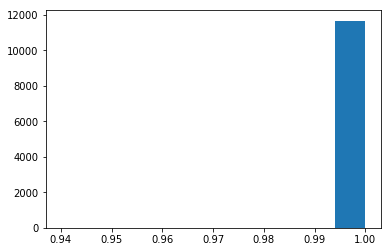

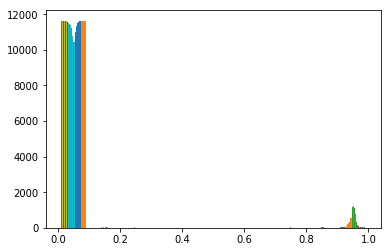

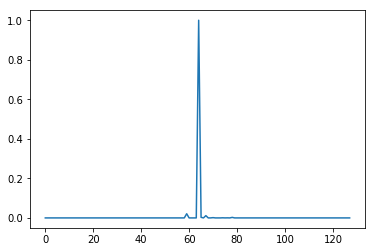

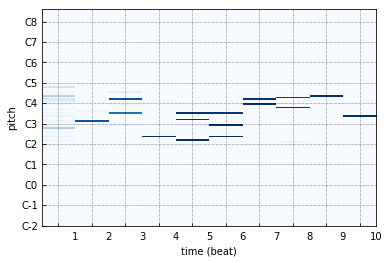

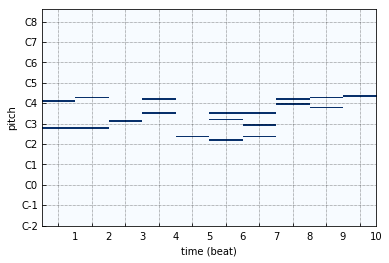

...

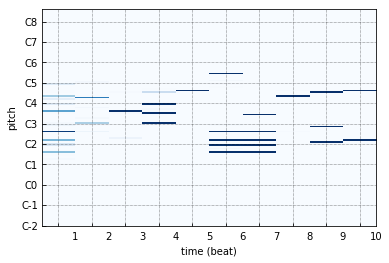

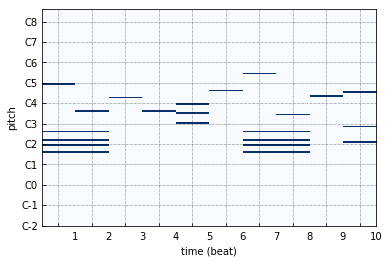

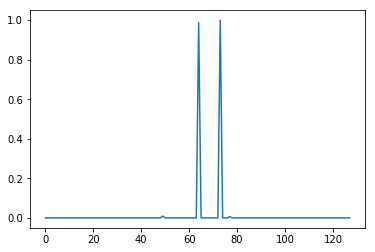

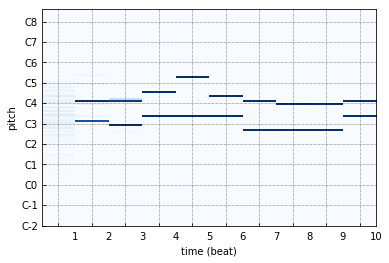

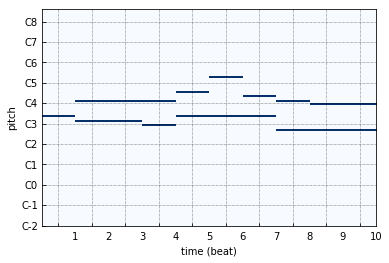

In [2]:
a = model.predict(train_xs, verbose=True)
print(model.layers[1].states[0])
print(model.layers[1].states[0])
maxes = [np.max(c) for c in a]
plt.hist(maxes)
plt.show()
plt.hist(a[:,-1])
plt.show()
b = np.max(a[1][-1])
plt.plot(a[0][-1])
plt.show()
prep.visualize_piano_roll(a[0].T, fs=1)
prep.visualize_piano_roll(train_xs[0].T, fs=1)
plt.plot(a[100][-1])
plt.show()
prep.visualize_piano_roll(a[100].T, fs=1)
prep.visualize_piano_roll(train_xs[100].T, fs=1)
plt.plot(a[200][-1])
plt.show()
prep.visualize_piano_roll(a[200].T, fs=1)
prep.visualize_piano_roll(train_xs[200].T, fs=1)

In [23]:
def make_song_from_predict(model, initial_data, limit):
    song = []
    keep_producing = True
    prev_data = initial_data
    while keep_producing and len(song) < limit:
        #print("input", prev_data)
        predictions = model.predict(np.array([prev_data]))[0]
        #print("output", predictions[-1])
        #plt.plot(predictions[-1])
        #plt.show()
        labels = np.zeros(predictions.shape)
        labels[predictions>0.5] = 1 # Weak activations, want to scale to 0/1
        last_output = labels[-1]
        #print("output scaled:", last_output)
        keep_producing = np.sum(last_output) != len(last_output)
        song.append(last_output)
        prev_data = np.append(prev_data[1:], [last_output], 0)
    return np.array(song)

initial_step = 1000
steps = 10
song = make_song_from_predict(model, train_xs[initial_step], sequence_length*steps)
prep.embed_play_v1(song.T, fs=1)


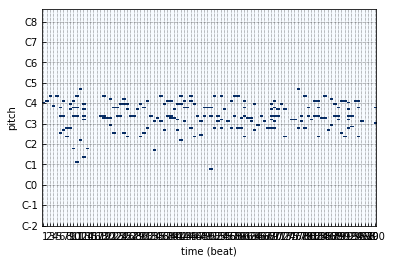

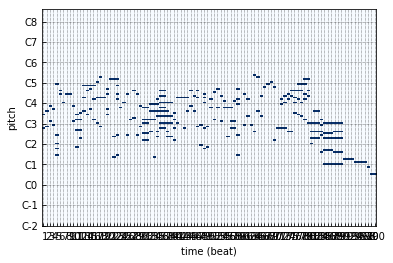

In [24]:
actual = train_xs[initial_step+1]
for i in range(1, steps):
    actual = np.append(actual, train_xs[initial_step+1+i], axis=0)
actual = actual.T
prep.visualize_piano_roll(song.T, fs=1)

prep.visualize_piano_roll(actual, fs=1)
prep.embed_play_v1(actual, fs=1)

In [29]:
print(model.layers[1].states)

[None, None]
